# CS294 - Project 2 - Part 2
Romil Bhardwaj

In [1]:
import numpy as np
import skimage as sk
import skimage.io as skio
import matplotlib.pyplot as plt
import matplotlib
from scipy.signal import convolve2d
from scipy.signal.windows import gaussian
from skimage.color import rgb2gray
from scipy.ndimage.interpolation import rotate
from skimage.transform import rescale, resize
from scipy.ndimage import gaussian_filter
import cv2
import os
from align_image_code import align_images

## 2.1 Sharpening Images

In [2]:
def get_gaussian(size, sigma):
    kernel = cv2.getGaussianKernel(size, sigma)
    return np.outer(kernel, np.transpose(kernel))

In [3]:
def sharpen(image, gaussian_kernel):
    unsharp_mask = np.zeros(gaussian_kernel.shape)
    gauss_size = gaussian_kernel.shape[0]
    unsharp_mask[gauss_size//2, gauss_size//2] = 2
    unsharp_mask -= gaussian_kernel
    channelwise_sharp = []
    for channel in range(image.shape[2]):
        s = convolve2d(image[:,:,channel], unsharp_mask, mode="same").reshape([image.shape[0], image.shape[1], 1])
        channelwise_sharp.append(s)
    sharpened_img = np.dstack(channelwise_sharp)
    return sharpened_img

def blur(image, gaussian_kernel):
    channelwise_blur = []
    for channel in range(image.shape[2]):
        s = convolve2d(image[:,:,channel], gaussian_kernel, mode="same").reshape([image.shape[0], image.shape[1], 1])
        channelwise_blur.append(s)
    blurred_img = np.dstack(channelwise_blur)
    return blurred_img

In [4]:
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 22})

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


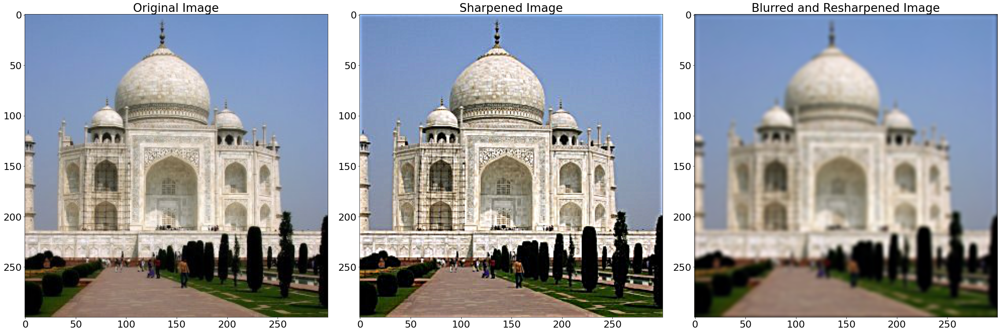

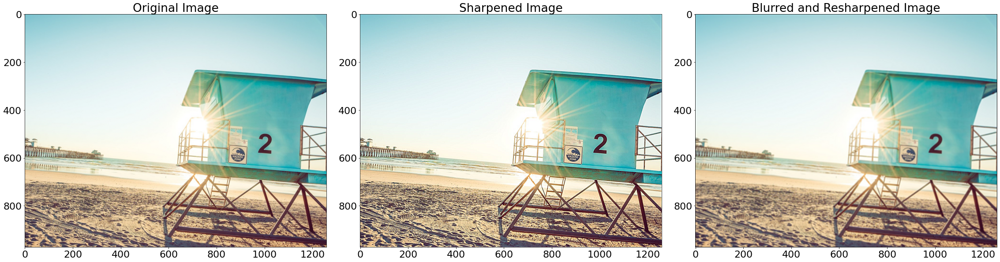

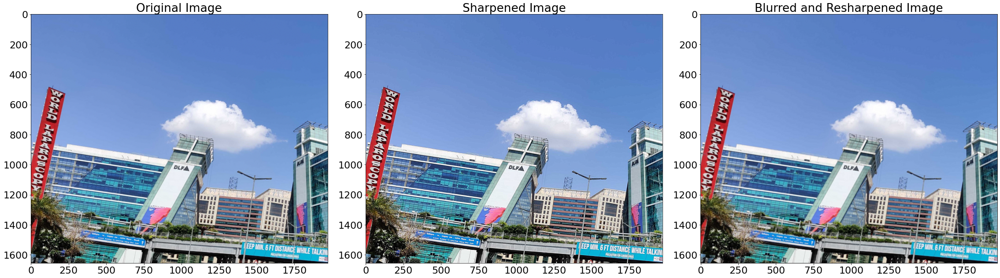

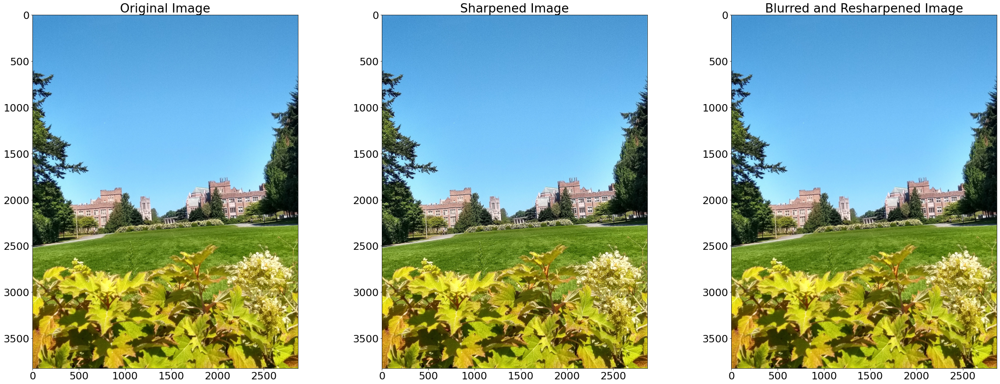

In [45]:
gaussian_kernel = get_gaussian(9, 2)
OUTPUT_PATH = 'outputs/sharpening'
os.makedirs(OUTPUT_PATH, exist_ok=True)
images = ['imgs/taj.jpg', 'imgs/beach.jpg', 'imgs/bldg.jpg', 'imgs/uwash.jpg']
for img_path in images:
    im = skio.imread(img_path)
    im = sk.img_as_float(im)
    # Regular sharpening
    sharpened_img = sharpen(im, gaussian_kernel)
    # Blur and sharpen again
    blur_resharp_img = sharpen(blur(im, gaussian_kernel), gaussian_kernel)
    
    nrow = 1; ncol = 3;
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(32, 12))
    axs = axs.reshape(-1)
    
    ax = axs[0]
    ax.set_title('Original Image')
    ax.imshow(im)
    
    ax = axs[1]
    ax.set_title('Sharpened Image')
    ax.imshow(sharpened_img)
    
    ax = axs[2]
    ax.set_title('Blurred and Resharpened Image')
    ax.imshow(blur_resharp_img)
    
    # Save output
    name = os.path.splitext(os.path.basename(img_path))[0]
    out_filename = 'sharpened_' + name + '.jpeg'
    out_path = os.path.join(OUTPUT_PATH, out_filename)
    plt.tight_layout()
    plt.savefig(out_path, bbox_inches='tight')

# 2.3 Hybrid Images
### Implemented in p2_22hybrid.py

# 2.4 Laplacian and Gaussian Stacks

In [68]:
def gaussian_stack(im, gaussian_kernel, stack_depth=7):
    stack = []
    blurred_image = im.copy()
    for i in range(stack_depth-1):
        blurred_image = blur(blurred_image.copy(), gaussian_kernel)
        stack.append(blurred_image)
    return [im] + stack

def laplacian_stack(im, gaussian_kernel, stack_depth=7):
    stack = []
    g_stack = gaussian_stack(im, gaussian_kernel, stack_depth)
    last_image = im.copy()
    for i in range(1, stack_depth):
        high_freq = (last_image - g_stack[i])
        stack.append(high_freq)
        last_image = g_stack[i].copy()
    return [im] + stack

def plot_stack(s, title='', save_path=''):
    nrow = 1; ncol = len(s);

    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(5*ncol, 12))
    axs = axs.reshape(-1)

    for i, ax in enumerate(axs):
        ax.set_title(f'{title} depth = {i}')
        ax.imshow(s[i])
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, bbox_inches='tight')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

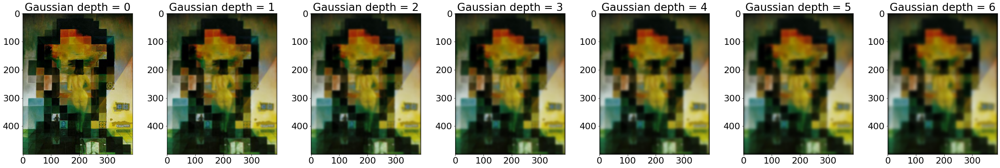

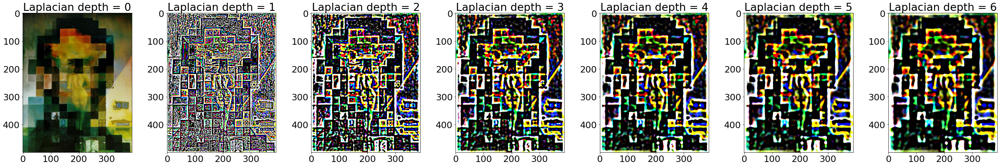

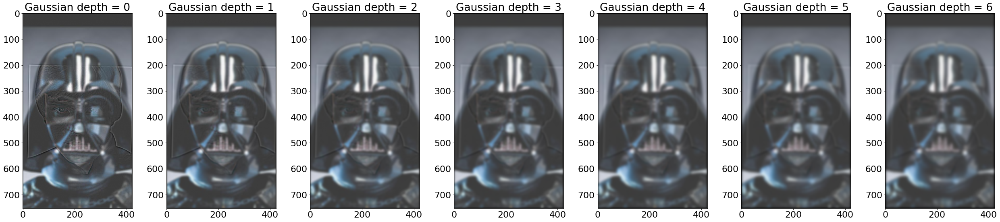

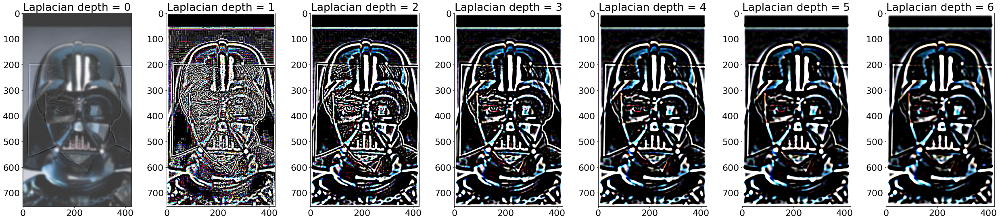

In [65]:
OUTPUT_PATH = 'outputs/stacks'
os.makedirs(OUTPUT_PATH, exist_ok=True)
imgs = ['imgs/lincoln.jpg', 'outputs/hybrid/lukevader.jpg']
for img_path in imgs:
    im = skio.imread(img_path)
    im = sk.img_as_float(im)
    gaussian_kernel = get_gaussian(15, 2)
    stack_depth = 7

    gauss_stack = gaussian_stack(im, gaussian_kernel, stack_depth)
    lapl_stack = laplacian_stack(im, gaussian_kernel, stack_depth)
    lapl_stack = [lapl_stack[0]] + [lapl*255 for lapl in lapl_stack[1:]] # Mult by 255 to fix imshow

    name = os.path.splitext(os.path.basename(img_path))[0]
    out_filename = 'gaussstack_' + name + '.jpeg'
    out_path = os.path.join(OUTPUT_PATH, out_filename)
    plot_stack(gauss_stack, "Gaussian", out_path)

    out_filename = 'laplstack_' + name + '.jpeg'
    out_path = os.path.join(OUTPUT_PATH, out_filename)
    plot_stack(lapl_stack, "Laplacian", out_path)

# Part 2.4 - Multiresolution Blending

In [69]:
# def get_thresholded_mask()

def blending(im1, im2, mask, gaussian_kernel, depth=5, mask_threshold = 0.3):
    mask = rgb2gray(mask)
    mask = mask > mask_threshold
    mask = np.dstack([mask, mask, mask]).astype(np.float32)
    mask_stack = gaussian_stack(mask, gaussian_kernel, depth)
    im1_stack = laplacian_stack(im1, gaussian_kernel, depth)
    im2_stack = laplacian_stack(im2, gaussian_kernel, depth)
    #plot_stack(im2_stack, "im2_stack", '')
    stacked_imgs = []
    for i in range(depth):
        stacked_imgs.append(mask_stack[i]*im1_stack[i] + (1 - mask_stack[i])*im2_stack[i])
    return sum(stacked_imgs), im1_stack, im2_stack, mask_stack

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

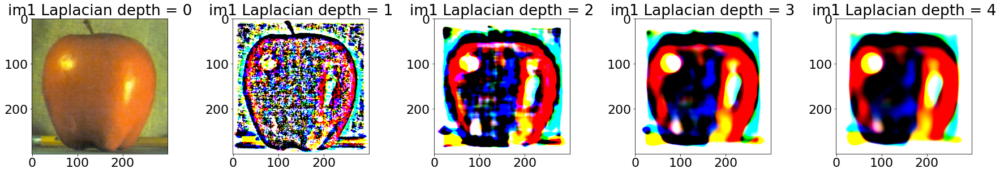

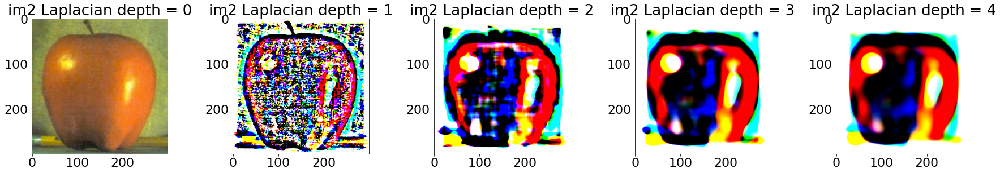

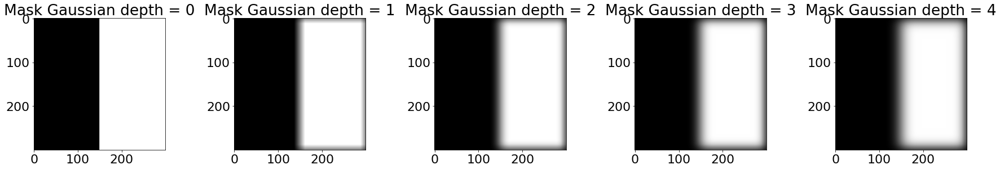

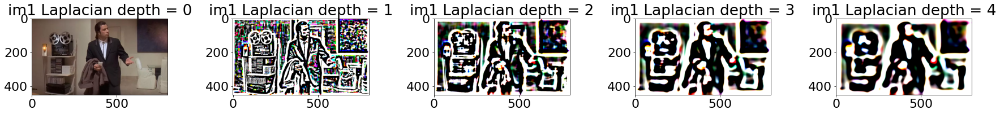

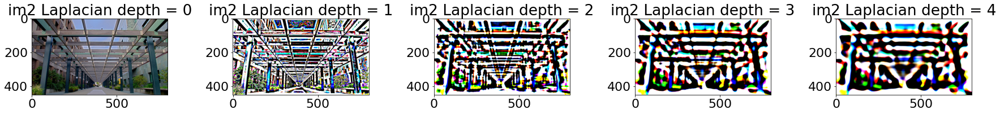

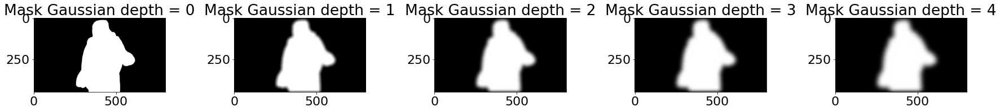

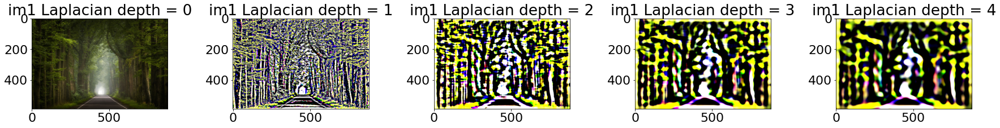

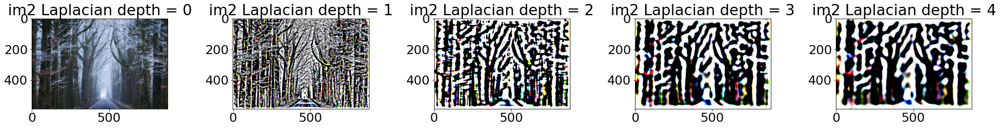

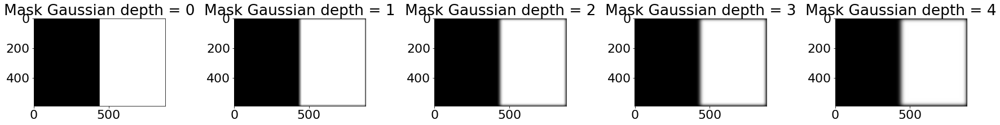

In [72]:
OUTPUT_PATH = 'outputs/multires/'
os.makedirs(OUTPUT_PATH, exist_ok=True)
gaussian_kernel = get_gaussian(25, 20)

imgs = [['imgs/apple.jpeg', 'imgs/apple.jpeg', 'imgs/oraple_mask.jpg'],
       ['imgs/travolta.jpg', 'imgs/sodahall.jpg', 'imgs/travolta_mask.jpg'],
       ['imgs/summer.jpg', 'imgs/winter.jpg', 'imgs/season_mask.jpg'],]
for im1_path, im2_path, mask_path in imgs:
    im1 = skio.imread(im1_path)
    im2 = skio.imread(im2_path)
    mask = skio.imread(mask_path)

    stacked, im1_stack, im2_stack, mask_stack = blending(im1, im2, mask, gaussian_kernel, depth=5)

    name = os.path.splitext(os.path.basename(im1_path))[0]
    out_path = os.path.join(OUTPUT_PATH, 'im1stack_' + name + '.jpeg')
    plot_stack(im1_stack, "im1 Laplacian", out_path)

    out_path = os.path.join(OUTPUT_PATH, 'im2stack_' + name + '.jpeg')
    plot_stack(im2_stack, "im2 Laplacian", out_path)

    out_path = os.path.join(OUTPUT_PATH, 'maskstack_' + name + '.jpeg')
    plot_stack(mask_stack, "Mask Gaussian", out_path)

# TEST

In [73]:
## 1.1

# Differential matrices
D_x = [[1, -1], [0, 0]]
D_y = [[1, 0], [-1, 0]]

# Helper functions to convolve the derivative on each axis
def convolve_x(src):
    return convolve2d(src, D_x)

def convolve_y(src):
    return convolve2d(src, D_y)

# Create a mask for the derivative images
def mask_image_derivative(dx, dy, threshold):
    mask_x = abs(dx[:,:]) > threshold
    mask_y = abs(dy[:,:]) > threshold
    return mask_x + mask_y

# Saves the borders produces by the derivative map
def borders_no_blur(image, output_name):
    thresh = 20
    dx = convolve_x(image)
    dy = convolve_y(image)
    mask = mask_image_derivative(dx, dy, thresh)
    io.imsave(output_name, img_as_uint(mask))


## 1.2

# Creates gaussian kernel
def get_gaussian_kernel(size, sigma):
    kernel = cv2.getGaussianKernel(size, sigma)
    return np.outer(kernel, np.transpose(kernel))

# Saves the blurred borders for the derivative map
def borders_blur(image, output_name):
    thresh = 20
    gauss = gaussian_kernel(20, 1.5)
    blurry = convolve2d(image, gauss)
    dx = convolve_x(blurry)
    dy = convolve_y(blurry)
    blurry_mask = mask_image_derivative(dx, dy, thresh)
    io.imsave(output_name, img_as_uint(blurry_mask))

# Saves the blurred borders for the derivative map using a preprocessed filter (DOF)
def borders_blur_dog(image, output_name):
    thresh = 20
    gauss = gaussian_kernel(20, 1.5)
    kernel_dx = convolve_x(gauss)
    kernel_dy = convolve_y(gauss)
    blurry_dx =  convolve2d(image, kernel_dx)
    blurry_dy =  convolve2d(image, kernel_dy)
    dof_blurry_mask = mask_image_derivative(blurry_dx, blurry_dy, thresh)
    io.imsave(output_name, img_as_uint(dof_blurry_mask))


## 1.3

# Crops an image given a split coefficient
def crop(image, divisor):
    x = image.shape[0]
    y = image.shape[1]
    x1 = int(x/divisor)
    x2 = x - int(x/divisor)
    y1 = int(y/divisor)
    y2 = y - int(y/divisor)
    return image[x1:x2, y1:y2]

# Calculates the number of perpendicular gradients
def how_many_perpendicular(image):
    # Counts perpendicular as in a range of 80 - 100 degrees
    return sum(sum(abs(abs(image[:,:]) - 90) < 10))

# Fixes the rotation for a channel
def fix_rotate(image):
    rotations = []
    # From -40 to 40 degrees of rotation skipping by 2 degrees
    for angle in range(-40, 40, 2):
        rotate_image = rotate(image, angle)
        # Crop the image in 5
        rotate_image = crop(rotate_image, 5)

        # Get the derivative maps for each axis and count the perpendicular angles
        dx = convolve_x(rotate_image)
        dy = convolve_y(rotate_image)
        this_num_horiz = how_many_perpendicular(dy)
        this_num_vert = how_many_perpendicular(dx)

        num_edges = this_num_horiz + this_num_vert
        rotations.append((num_edges, angle, (dx, dy)))

    # return the best count for the angles
    return max(rotations, key=lambda x: x[0])

# Fix the rotation for a channel and apply it for the others
def fix_rotate_color(image_name):
    img = io.imread(image_name)
    # Fix the 1st channel
    rotation = fix_rotate(img[:,:,0])
    angle = rotation[1]
    image_name = image_name.replace(".", "").replace("/", "").replace("jpg", "")
    image_histogram_name = "histogram_" + image_name
    dif = np.concatenate([rotation[2][0], rotation[2][1]])
    fig = hist(dif)
    # Save the histogram of angles
    plt.savefig(image_histogram_name)

    # If the image doesn't have more than one channel, return the channel
    if len(img.shape) < 3 or img.shape[2] == 1:
        return rotate(img, angle)

    # Else, apply the rotation to all of the channels
    R = rotate(img[:,:,0], angle)
    G = rotate(img[:,:,1], angle)
    B = rotate(img[:,:,2], angle)
    return np.dstack([R, G, B])

# Saves the fixed image
def fix_image(image_name, output_name):
    io.imsave(output_name, fix_rotate_color(image_name))


## 2.1

# Sharps an image
def sharpen(image, sz, sigma):
    gauss = get_gaussian_kernel(sz, sigma)
    lapl = np.zeros(gauss.shape)
    lapl[int(sz/2), int(sz/2)] = 1
    lapl = 2*lapl - gauss
    image = img_as_float(image)
    shape = image.shape
    RGB_shape = (shape[0], shape[1], 1)
    blurry_0 = convolve2d(image[:,:,0], lapl, mode="same").reshape(RGB_shape)
    blurry_1 = convolve2d(image[:,:,1], lapl, mode="same").reshape(RGB_shape)
    blurry_2 = convolve2d(image[:,:,2], lapl, mode="same").reshape(RGB_shape)

    final = np.dstack([blurry_0, blurry_1, blurry_2])
    return final

# Saves the sharpen image
def save_sharp(image, sz, sigma, output_image):
    sharp = sharpen(image, sz, sigma)
    io.imsave(output_image, sharp)


## 2.2

# Creates a hybrid image
def hybrid_image(im1, im2, s1, s2, output_image, gray1=False, gray2=False):
    im2, im1 = align_images(im2, im1)
    im1 = im1 / np.max(im1)
    im2 = im2 / np.max(im2)
    kernel_1 = get_gaussian_kernel(25, s1)
    # Blur every channel
    im1_blurry_0 = convolve2d(im1[:,:,0], kernel_1, mode="same")
    im1_blurry_1 = convolve2d(im1[:,:,1], kernel_1, mode="same")
    im1_blurry_2 = convolve2d(im1[:,:,2], kernel_1, mode="same")
    blurry_im1 = np.dstack([im1_blurry_0, im1_blurry_1, im1_blurry_2])

    kernel_2 = get_gaussian_kernel(25, s2)
    # Blur every channel
    im2_blurry_0 = convolve2d(im2[:,:,0], kernel_2, mode="same")
    im2_blurry_1 = convolve2d(im2[:,:,1], kernel_2, mode="same")
    im2_blurry_2 = convolve2d(im2[:,:,2], kernel_2, mode="same")
    blurry_im2 = np.dstack([im2_blurry_0, im2_blurry_1, im2_blurry_2])

    # Get high frequencies for image 2
    high_freq = im2 - blurry_im2

    if gray1:
        blurry_im1 = rgb2gray(blurry_im1)
        blurry_im1 = np.dstack([blurry_im1, blurry_im1, blurry_im1])
    if gray2:
        high_freq = rgb2gray(high_freq)
        high_freq = np.dstack([high_freq, high_freq, high_freq])

    final_hybrid = blurry_im1/2 + high_freq/2
    io.imsave(output_image, final_hybrid)


## 2.3

# Generates a gaussian stack
def gaussian_stack(image, size, sigma):
    gauss = get_gaussian_kernel(size, sigma)
    stack = [image]
    for i in range(0,6):
        blur_0 = convolve2d(stack[i][:, :, 0], gauss, mode="same")
        blur_1 = convolve2d(stack[i][:, :, 1], gauss, mode="same")
        blur_2 = convolve2d(stack[i][:, :, 2], gauss, mode="same")
        final_blur = np.dstack([blur_0, blur_1, blur_2])
        final_blur = final_blur
        stack.append(final_blur)
    return stack[1:]

# Generates a laplacian stack
def laplacian_stack(image, size, sigma):
    stack = [image]
    gauss_stack = gaussian_stack(image, size, sigma)
    buf = image
    for i in range(0,5):
        # Get the correspondant high frequencies for each blurred layer
        sharp = (buf - gauss_stack[i])
        buf = gauss_stack[i]
        stack.append(sharp/255)

    stack.append(gauss_stack[-1]/255)
    return stack[1:]

# Save the stacks for a given picture
def show_stack(image, size, sigma, output_image):
    gauss_stack = gaussian_stack(image, size, sigma)
    gauss_stack = [gauss/255 for gauss in gauss_stack]
    lapl_stack = laplacian_stack(image, size, sigma)
    lapl_stack = [lapl/255 for lapl in lapl_stack]
    fig_gauss = np.concatenate(gauss_stack[:], axis=1)
    io.imsave(output_image + "_gaussianStack.jpg", fig_gauss)
    fig_lapl = np.concatenate(lapl_stack[:], axis=1)
    io.imsave(output_image + "_laplacianStack.jpg", fig_lapl)


## 2.4

# Creates a multiresolution blend for two images and a given mask
def multiresolution_blending(A, B, R, size, sigma, gray):
    # Easy way to simulate grayscale without changing the other methods
    if gray:
        A = rgb2gray(A)
        A = np.dstack([A, A, A])
        B = rgb2gray(B)
        B = np.dstack([B, B, B])
        if np.max(A) <= 1:
            A *= 255
        if np.max(B) <= 1:
            B *= 255

    R = rgb2gray(R)
    # Apply a mask to make sure the image is 1 or 0
    R = R[:,:] > 0.2
    # Easy way to simulate grayscale without changing the other methods
    R = np.dstack([R, R, R])
    LA = laplacian_stack(A, size, sigma)
    LB = laplacian_stack(B, size, sigma)
    GR = gaussian_stack(R, size, sigma)

    LS = []
    for i in range(0, len(LA)):
        LS.append(GR[i]*LA[i] + (1 - GR[i])*LB[i])

    LS = sum(LS)

    return LS, LA, LB, GR

def plot_stack(s, title='', save_path=''):
    nrow = 1; ncol = len(s);

    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(5*ncol, 12))
    axs = axs.reshape(-1)

    for i, ax in enumerate(axs):
        ax.set_title(f'{title} depth = {i}')
        ax.imshow(s[i])
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, bbox_inches='tight')

In [74]:
gaussian_kernel = get_gaussian(25, 20)

im1_path = 'imgs/apple.jpeg'
im2_path = 'imgs/orange.jpeg'
mask_path = 'imgs/oraple_mask.jpg'

im1 = skio.imread(im1_path)
im2 = skio.imread(im2_path)
mask = skio.imread(mask_path)

ls, la, lb, gr = multiresolution_blending(im1, im2, mask, 25, 20, False)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


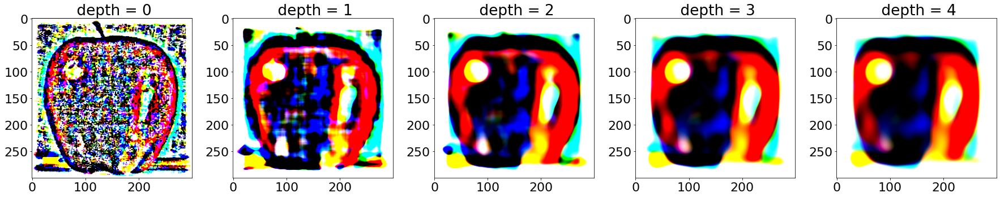

In [30]:
plot_stack([x*255 for x in la[:-1]], "im1 Laplacian")
plot_stack([x*255 for x in la[:-1]], "im2 Laplacian")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


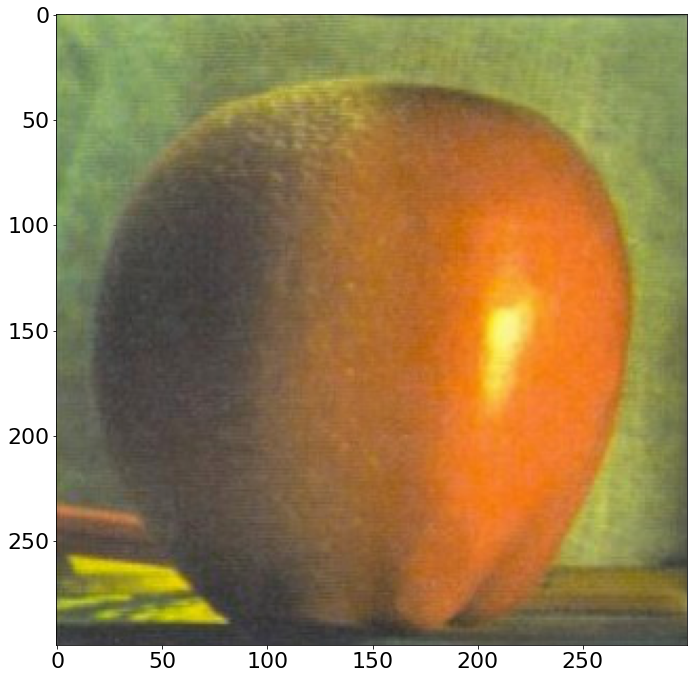

In [79]:
plt.figure(figsize=(10,10))
plt.imshow(ls)
plt.tight_layout()
plt.savefig('outputs/multires/oraple.jpg', bbox_inches='tight')

TypeError: Image data of dtype object cannot be converted to float

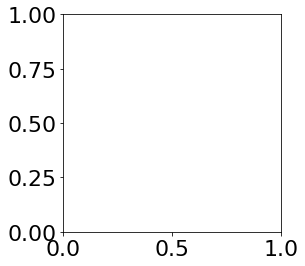

In [81]:
gaussian_kernel = get_gaussian(15, 2)

im1_path = 'imgs/travolta.jpg'
im2_path = 'imgs/sodahall.jpg'
mask_path = 'imgs/travolta_mask.jpg'

im1 = skio.imread(im1_path)
im2 = skio.imread(im2_path)
mask = skio.imread(mask_path)

ls, la, lb, gr = multiresolution_blending(im1, im2, mask, 25, 20, False)
plt.imshow(ls)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


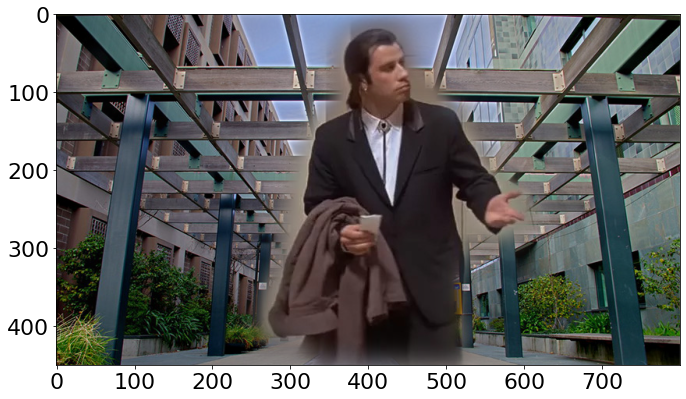

In [85]:
plt.figure(figsize=(10,10))
plt.imshow(ls[0])
plt.tight_layout()
plt.savefig('outputs/multires/travolta.jpg', bbox_inches='tight')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


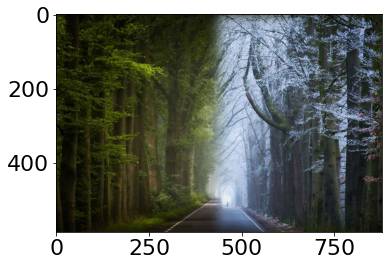

In [86]:
gaussian_kernel = get_gaussian(15, 2)

im1_path = 'imgs/winter.jpg'
im2_path = 'imgs/summer.jpg'
mask_path = 'imgs/season_mask.jpg'

im1 = skio.imread(im1_path)
im2 = skio.imread(im2_path)
mask = skio.imread(mask_path)

ls, la, lb, gr = multiresolution_blending(im1, im2, mask, 25, 20, False)
plt.imshow(ls)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


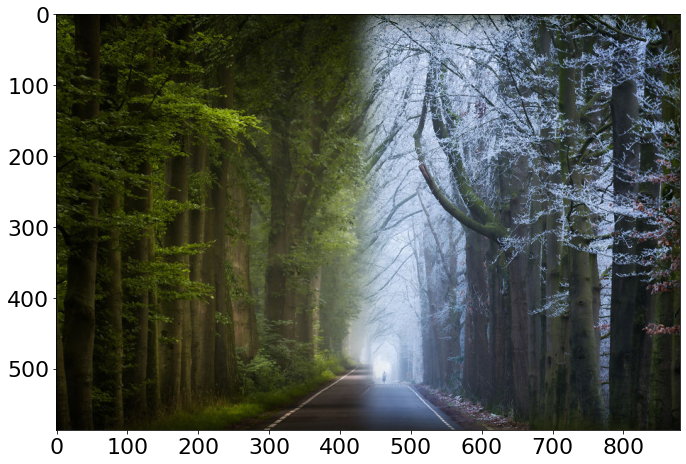

In [87]:
plt.figure(figsize=(10,10))
plt.imshow(ls)
plt.tight_layout()
plt.savefig('outputs/multires/seasons.jpg', bbox_inches='tight')